# Разработка алгоритма привлечения новых клиентов среди родственников текущих клиентов банка

Данное исследование проводится с рамках развития продукта семейного банкинга

# Постановка задачи

Построить модель бинарной классификации данных, которая позволит
найти новых клиентов среди родственников текущих пользователей услуг
Альфа-Банка.
Для этого:
1. Самостоятельно собрать таргет, используя информацию о держателях
и пользователях карты.
2. Обучить модель, используя приведенный датасет. По результатам обучения выбрать лучшую модель из нескольких вариантов.
3. Предложить методы коммуникации с выбранным сегментом пользовательской базы для максимальной персонализации предложения.
Процесс коммуникации может варьироваться с учетом особенностей
пользователей.
4. Составить дорожную карту развития проекта сроком на 1 год.

# Описание данных

Таблица *`objects_cup.xlsx`* содержит информацию о картах, информацию о владельцах и пользователях кодированном виде

`card_uk` - id карты

`cardapp_date` - дата открытия карты

`owner_id` - id владельца карты

`holder_id` - id держателя карты

Таблица *`feat_cup.csv`* содержит информацию о клиенте(возраст, пол, доход, сегмент, страна, трансации по разным категориям и другие признаки). Всего 293 колонки. О полном составе таблицы можно ознакомится ниже



In [1]:
# импортируем необходимые библиотеки

import pandas as pd
import numpy as np
pd.options.display.max_columns=100

from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

from warnings import filterwarnings
filterwarnings('ignore')

In [2]:
# цветовые палитры АльфаБанка

colors_ab = ['#d1d5d8', '#EF3124', '#000000', '#08628C', '#532371', '#A9ACAE', '#E4E4E4','#000000',  '#737677', '#88dbdf', '#FFFFFF']
cmap_ab = ListedColormap(colors_ab)

In [3]:
params = {
    'figure.figsize': [8, 6],
    'axes.grid': False,
    'xtick.labelsize': 8,
    'ytick.labelsize': 8,
    'axes.labelsize': 12,
    'axes.edgecolor': 'white',
    'image.cmap': 'viridis',
    'lines.linewidth': 1,
    'lines.color': 'gray'
}

# sns.set()
# %config InlineBackend.figure_format = 'svg'
sns.set_style("whitegrid")
plt.rcParams.update(params)

## Подготовка датасета

In [4]:
from google.colab import drive
import sys
import os

drive.mount('/content/drive')
path = '/content/drive/My Drive/work/alpha_cup/data/'
sys.path.append(os.path.abspath(path))


Mounted at /content/drive


In [5]:
# список колонок с основными данными о пользователях
easy_feat = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='easy_feat')
easy_feat_col = easy_feat['name_feat'].to_list()

# изначальный датафрейм с данными
fc = pd.read_csv(path + 'feat_cup.csv')

# датафрейм для валидации
val_df = pd.read_csv(path + 'feat_cup_val_alfa.csv')

# датафрейм с данными о держателях карт и холдерах
object_df = pd.read_csv(path + 'objects_cup.csv')

In [7]:
fc.head()

,client_id,dt,accountsalary_flag,country,profit_income_out_rur_amt_6m,clientoutflowstatus,curbal_usd_amt_cm_avg,stratsegfactor,srvpackage,clientsegment,age,gender,addrref,life_time_days,profit_income_out_rur_amt_3m,profit_income_out_rur_amt_12m,profit_income_out_rur_amt_9m,turn_save_db_sum_v2,avg_invest_inc,avg_percents_inc,avg_save_db_turn,card_dda_rur_amt_3m_avg,depos_rur_amt_curr_v2,total_inc,dda_rur_amt_3m_avg,accum_rur_amt_3m_avg,dda_rur_amt_cm_avg,card_dda_rur_amt_curr_v2,sal_rur_amt_curr_v2,diff_save_cr_db_turn,avg_zp_inc,avg_cur_db_turn,depos_rur_amt_3m_avg,turn_save_db_avg_act_v2,total_rur_amt_cm_avg,avg_credit_turn_rur,depos_rur_amt_cm_avg,accum_rur_amt_cm_avg,total_rur_amt_curr_v2,diff_cur_cr_db_turn,curr_rur_amt_curr_v2,total_rur_amt_3m_avg,accum_rur_amt_curr_v2,curr_rur_amt_3m_avg,turn_fdep_cr_avg_act_v2,cred_dda_rur_amt_curr_v2,avg_save_cr_turn,tda_rur_amt_3m_avg,curr_rur_amt_cm_avg,avg_cur_cr_turn,...,transaction_category_entertainment_sum_cnt_m2,transaction_category_house_repair_sum_cnt_m2,transaction_category_other_retail_purchase_sum_amt_m2,transaction_category_clothers_shoes_percent_cnt_2m,transaction_category_bank_online_sum_cnt_m2,transaction_category_airplane_tickets_inc_cnt_2m,transaction_category_money_send_inc_amt_2m,transaction_category_house_repair_percent_amt_2m,transaction_category_other_retail_purchase_percent_amt_2m,transaction_category_general_store_percent_cnt_2m,transaction_category_supermarket_percent_cnt_2m,transaction_category_supermarket_sum_amt_m2,transaction_category_money_send_inc_cnt_2m,transaction_category_entertainment_percent_amt_2m,transaction_category_fastfood_percent_cnt_2m,transaction_category_pharmacy_percent_amt_2m,transaction_category_money_send_sum_amt_m2,transaction_category_sporting_goods_sum_amt_m2,transaction_category_auto_services_inc_amt_2m,transaction_category_transport_inc_cnt_2m,transaction_category_clothers_shoes_sum_amt_m2,transaction_category_clothers_shoes_percent_amt_2m,transaction_category_pharmacy_percent_cnt_2m,transaction_category_cash_percent_amt_2m,transaction_category_restaurants_sum_cnt_m2,transaction_category_fuel_sum_cnt_m2,transaction_category_general_store_inc_amt_2m,transaction_category_airplane_tickets_sum_amt_m2,transaction_category_fuel_percent_amt_2m,transaction_category_transport_percent_cnt_2m,transaction_category_cash_inc_cnt_2m,transaction_category_fastfood_percent_amt_2m,transaction_category_fuel_inc_amt_2m,transaction_category_general_store_sum_cnt_m2,transaction_category_restaurants_sum_amt_m2,transaction_category_entertainment_percent_cnt_2m,transaction_category_transport_sum_cnt_m2,transaction_category_restaurants_inc_amt_2m,transaction_category_bank_online_sum_amt_m2,transaction_category_sporting_goods_percent_amt_2m,transaction_category_house_repair_inc_cnt_2m,transaction_category_cash_percent_cnt_2m,transaction_category_hotels_sum_cnt_m2,transaction_category_sporting_goods_inc_amt_2m,transaction_category_airplane_tickets_percent_amt_2m,transaction_category_transport_percent_amt_2m,transaction_category_restaurants_percent_amt_2m,transaction_category_auto_services_percent_amt_2m,transaction_category_supermarket_sum_cnt_m2,transaction_category_auto_services_sum_cnt_m2
0,945a859f1e692f572658a658f7035d40d3d914b920a0ed...,2021-08-31,1.0,RUS,316.333333,ACTIVE,1358.0,Остатки на счетах,Технический,MASS,51.0,Мужской,г. Москва,6636.0,-26.333333,533.916667,420.666667,1.754052e+06,0.0,0.0,103175.0,0.0,0.0,69453.0,142888.0,38259.0,151762.0,0.0,0.0,145132.0,0.0,286140.0,0.0,5.846841e+05,151762.0,452454.0,0.0,100427.0,266750.0,-81993.0,26356.0,142888.0,240395.0,104629.0,NaN,0.0,248307.0,0.0,51335.0,204147.0,...,5.0,8.0,16431.00,0.009302,2.0,0.811111,NaN,0.123945,0.067324,0.013953,0.493023,71589.93,NaN,0.007006,0.041860,0.018984,NaN,7693.0,NaN,1.789216,9112.0,0.037335,0.032558,0.204868,4.0,14.0,0.414819,598.0,0.088836,0.046512,1.216667,0.014267,2.843177,3.0,1262.00,0.023256,10.0,6.083333,4800.0,0.031521,0.695238,0.004651,1.0,2.275113,0.002450,0.0382

In [8]:
object_df.head()

,card_uk,cardapp_date,owner_id,holder_id
0,2.874125e+11,2022-06-25,024cd10895b635113236b38ab005261aabe2d14fea7f35...,024cd10895b635113236b38ab005261aabe2d14fea7f35...
1,3.672372e+11,2023-02-15,d2107fec5e57fd346ce4c24787a251171c58b8772fb4ea...,877e6c0cffe3b3a9d584bb8d3bdc2b5268693650b050ba...
2,1.961967e+11,2021-08-25,c76c421c338190a6f9581952a4d663b20b7d5a722f883f...,c76c421c338190a6f9581952a4d663b20b7d5a722f883f...
3,1.711414e+11,2021-05-26,4b6bed0a9c16977f19606b59547801f6493754aaf493f3...,4b6bed0a9c16977f19606b59547801f6493754aaf493f3...
4,9.197256e+10,2019-12-10,e0fa8dd8a0a0c142bd298f071bc3e7ce85c86296bad189...,e0fa8dd8a0a0c142bd298f071bc3e7ce85c86296bad189...


В датафрейме *`fc`*  имееет следущие проблемы:
- Дублирущиеся данные. Например, сумма транзакций по одной из категорий за период 1, 3, 6, 9, 12 месяцев. Логично их как то объединить и получить один признак. Тем самым мы избавляемся от мультиколлинеарности в этих колонках и снижаем размерность признаков. И в добавок можно с помощью это решить и вторую проблему
- Пропущенные значения можно заполнить, с помощью объединения ячеек в одной категории. Так же мы будем использовать *KNNImputer* в тех случаях, когда заполнить из исходных данных будет не возможно

Для выделения таргета прибегнем к следующей гипотезе:
Если мы хотим выйти на членов семьи уже текущих клиентов АльфаБанка, выделим с в семье условного "кормильца". То есть человек больше всех зарабатывет в семье, больше всех расходов и возможно является владельем карты, которому привязаны разные держатели карт. На основе этого выделим из таблицы *`object_df`* id тех пользователей, где одному *owner* сооветвует несколько разных *holder*. На основании этого сформируем наш таргет `is_sponsor`, проведем EDA анализ и при состоятельности гипотезы, выполним обучение моделей машинного обучения

In [ ]:
# словари с новыми информативными названиями колонок

columns_to_map = ['clientoutflowstatus', 'srvpackage']
dct_clientoutflowstatus, dct_srvpackage = {}, {}
dicts = [dct_clientoutflowstatus, dct_srvpackage]
anti_dicts = []
for idx, col in enumerate(columns_to_map):
    values = list(fc[col].dropna().unique())
    dicts[idx] = dict(zip(values, range(len(values))))

for dct in dicts:
    anti_dct = {k: v for v, k in dct.items()}
    anti_dicts.append(anti_dct)


In [ ]:

# функция для преобразовывания датафрейма в список словарей

def make_dict_from_df():
    # эксель файл с данными по счетам, сгруппированные по типам
    ctl = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='new_features')
    ctl = ctl.fillna(0)

    nan_dict = []
    for num in range(ctl.shape[0]):
        string = ctl.iloc[num]
        lst = [[string[0], string[1], string[2]]]
        dct={}
        for i in range(3, len(string), 2):
            if string[i] != 0:
                dct[string[i]] = string[i + 1]
        lst.append(dct)
        nan_dict.append(lst)
    return nan_dict

# функция для заполнения нанов из колонок, эквивалентных по смыслу
def make_good_cols(data):
    # создаем словарь
    nan_dict = make_dict_from_df()

    # создаем новый датафрейм
    df = pd.DataFrame()

    for col in nan_dict:
        old_name, koeff, new_name = col[0]
        df[new_name] = data[old_name] / koeff
        for name_nan, val_nan in col[1].items():
            df[new_name] = df[new_name].fillna(data[name_nan] / val_nan)

    return df

# функция считает среднее значение по колонкам с категориями покупок
def add_avg_bill(df_new, df_initial):
    avg_bill = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='avg_bill')
    df_new = df_new.copy()

    for row in range(len(avg_bill)):
        new_name, sum_in_cat, count_in_cat = avg_bill.loc[row].to_list()
        df_new[new_name] = df_initial[sum_in_cat] / df_initial[count_in_cat]

    return df_new

# функция для заполнения nan через KNNImputer
def filling_nans(df):
    # выделяем числовые колонки
    num_cols = df.loc[:, df.dtypes != 'object'].columns
    finance_cols = [i for i in num_cols if i not in ['accountsalary_flag', 'age', 'gender']]

    # заполняем финансовые колонки нулями
    df[finance_cols] = df[finance_cols].fillna(0)
    print(2)
    # кодирование категориальных колонок
    columns_to_map = ['srvpackage', 'gender', 'clientoutflowstatus']
    for col in columns_to_map:
        values = list(df[col].dropna().unique())
        # name = 'dct' + col
        col_dct = dict(zip(values, range(len(values))))

        df[col] = df[col].map(col_dct)
    print(3)
    # временный датафрейм, с числовыми признаканми для заполнения nan
    tmp_df = df.drop(['client_id', 'dt', 'addrref', 'clientsegment', 'stratsegfactor'], axis=1)

    # scaler=StandardScaler()
    # tmp_df_sc = scaler.fit_transform(tmp_df)
    # tmp_df_sc = pd.DataFrame(tmp_df_sc, columns=tmp_df.columns)

    print(4)
    columns_to_fill = ['gender', 'age', 'accountsalary_flag', 'clientoutflowstatus', 'srvpackage'] #
    imputer = KNNImputer(n_neighbors=5)
    imputer.fit(tmp_df)
    for col in columns_to_fill:
        col_idx = tmp_df.columns.get_loc(col)
        result = imputer.transform(tmp_df)
        df[col] = result[:, col_idx]

    return df

def preprocessing_data(data):
    df = make_good_cols(data)
    df = add_avg_bill(df, data)
    df = pd.concat((data[easy_feat_col], df), axis=1)

    # удаляем пользователей, которые пользуюся картой меньше, чем 30 дней
    df = df[df['life_time_days'] > 30]

    # удаляем колонку страна, так как пользователей не из России меньше, чем 1%
    # df = df[df['country'] == 'RUS']
    df.drop('country', axis=1, inplace=True)

    df = filling_nans(df)

    # в остальных колонках nans заполняем модой
    df['addrref'] = df['addrref'].fillna(df['addrref'].mode()[0])
    df['clientsegment'] = df['clientsegment'].fillna(df['clientsegment'].mode()[0])
    df['stratsegfactor'] = df['stratsegfactor'].fillna(df['stratsegfactor'].mode()[0])

    # возвращаем названия категориальных колонок
    for idx, col in enumerate(['clientoutflowstatus', 'srvpackage']):
        df[col] = df[col].map(anti_dicts[idx])


    return df



In [ ]:
df = preprocessing_data(fc)
df_validation = preprocessing_data(val_df)

2
3
4


In [ ]:
df.shape, fc.shape

((219653, 90), (291882, 293))

In [ ]:
df.head(3)

,client_id,dt,accountsalary_flag,clientsegment,age,gender,addrref,life_time_days,srvpackage,stratsegfactor,clientoutflowstatus,avg_income_avg_oper,avg_income_avg_invest,avg_income_avg_percent,avg_income_total,avg_balance_own,avg_balance_current,amount_balance_salary,avg_balance_depos_funded,avg_balance_depos_depos,tot_turnover_curr,avg_turnover_curr,qty_trans_moneysend,amount_trans_moneysend,amount_avg_by_phone_perevod,amount_avg_external_perevod,qty_credit_morgage,qty_credit_total,qty_credit_auto,qty_credit_main_person,amount_obrazovanie_month,amount_parkovki_month,amount_kosmetika_month,amount_gipermarkety_month,amount_tovary_dlja_detej_month,amount_zarubezhnye_finansovye_operatsii_month,amount_zdorove_month,amount_taksi_month,amount_supermarkety_month,amount_elektrichki_month,amount_set_supermarketov_month,amount_cotovaja_svjaz_month,amount_kino_month,amount_kafe_month,amount_kafe_pekarni_month,amount_kofejni_month,amount_meditsinskie_tsentry_month,amount_elektronnye_dengi_month,amount_flowers_month,amount_marketplaces_month,amount_bars_and_pubs_month,amount_hobby_month,amount_obsluzhivanie_kompjuterov_month,amount_avtozapchasti_month,amount_alkogol_month,amount_bytovaja_tehnika_month,amount_tovary_i_uslugi_month,amount_produkty_month,amount_pokupka_odezhdy_online_month,amount_torgovye_tsentry_month,amount_zoomagaziny_month,amount_books_month,amount_kommunalnye_uslugi_month,amount_avtomojki_month,amount_travel_month,amount_vydacha_nalichnyh_v_bankomate_month,amount_detskaja_odezhda_month,razvlechenija_avg_bill,general_store_avg_bill,money_send_avg_bill,hotels_avg_bill,krasota_or_bank_online_avg_bill,auto_services_avg_bill,fastfood_avg_bill,other_retail_purchase_avg_bill,supermarket_avg_bill,transport_avg_bill,fuel_avg_bill,clothers_shoes_avg_bill,airplane_tickets_avg_bill,house_repair_avg_bill,cash_avg_bill,sporting_goods_avg_bill,restaurants_avg_bill,pharmacy_avg_bill,is_sponsor
0,945a859f1e692f572658a658f7035d40d3d914b920a0ed...,2021-08-31,1.0,MASS,51.0,0.0,г. Москва,6121.350566,Технический,Остатки на счетах,ACTIVE,533.916667,81.207932,0.000000,69453.0,142888.0,1358.000000,0.0,38259.0,0.0,1.754052e+06,286140.0,0.0,0.0,164.383562,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,800.0,13114.18,0.0,0.0,0.000000,0.00,4437.633333,342.000000,3635.3,293.333333,0.0,683.333333,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,802.333333,0.0,4899.3,8276.333333,2669.666667,5779.523333,0.0,263.333333,0.0,52.666667,978.736667,0.0,2218.333333,16666.666667,0.0,342.0,712.833333,0.0,3251.25,2400.0,0.0,386.888889,821.55,675.376698,932.600000,1548.659286,4556.0,299.000000,3781.25,50000.00000,1538.6,315.5,661.885714,1
1,8e373b7f76b69fc21fd8e2ce416c620a86f59c6ccfe613...,2022-04-30,1.0,AFFLUENT,42.0,0.0,г. Москва,6063.001916,Премиум,Пакет услуг,ACTIVE,-3478.009015,-69.851306,38735.018712,783599.0,6515622.0,40523.494426,0.0,514389.0,0.0,4.644017e+07,4974609.0,0.0,0.0,115257.534247,0.0,-56.310838,11.0,0.0,15.0,15432.547244,0.0,0.0,0.00,0.0,0.0,13596.666667,4472.45,22800.000000,4782.573834,0.0,0.000000,0.0,47134.500000,0.0,0.0,3166.666667,0.0,5976.661481,0.0,670.0,0.0,0.000000,0.0,0.0,0.000000,34629.048852,61915.836583,0.0,0.000000,0.0,1334.501862,0.000000,0.0,51362.109625,543185.333333,0.0,0.0,0.000000,0.0,6030.00,0.0,0.0,795.416667,2398.00,753.000000,1100.561429,0.000000,0.0,44638.647995,0.00,399686.84265,0.0,3375.0,0.000000,0
2,df59a4122b39a1fbd34c9c44568540ae785dacdda37bcd...,2022-03-31,1.0,MASS,43.0,0.0,г. Москва,6134.972358,Эконом,Остатки на счетах,POTENTIAL,0.000000,54.674366,0.000000,0.0,54.0,0.000000,0.0,0.0,0.0,0.000000e+00,13.0,0.0,0.0,0.000000,0.0,0.000000,8.0,1.0,10.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.000000,0.00,0.000000,0.000000,0.000000,0.0,0.000000,0.00,0.00000,0.0,0.0,0.000000,0


In [ ]:
# датасет с оунерами-холдерами

# убираем дубликаты в данных
object_df = object_df.sort_values(by='cardapp_date')
object_df = object_df.drop_duplicates(subset=['holder_id', 'owner_id'], keep='last')


# создаем датафрейм с колонкой, где 1 - это владельцы карт с более чем 1 холдером
client_df = object_df.groupby('owner_id')['holder_id'].count()
client_df = pd.DataFrame(client_df).reset_index().rename(columns={'owner_id': 'client_id',
                                                           'holder_id': 'is_sponsor'})
client_df['is_sponsor'] = client_df['is_sponsor'].apply(lambda x: 0 if x <= 1 else 1)

In [ ]:
# прикрепляем фичу с владельцами карт к основному датасету

df = pd.merge(df, client_df, on='client_id', how='left')

In [ ]:
# выделяем вещественные колонки

num_cols = df.loc[:, df.dtypes != 'object'].columns
num_cols = [col for col in num_cols if col not in['accountsalary_flag', 'age']]

In [ ]:
# переводим возраст и флаг в категориальные фичи
df[['accountsalary_flag', 'age']] = df[['accountsalary_flag', 'age']].astype('object')

# выделяем вещественные колонки
num_cols = df.loc[:, df.dtypes != 'object'].columns


Оценим корреляцию между признаками

In [ ]:
# оценка попарных корреляций

def get_redundant_pairs(df):
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i + 1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop


def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)

    return pd.DataFrame(au_corr[0: n])


print("Top Absolute Correlations")
corrs = get_top_abs_correlations(df[num_cols], 10)
print(corrs)


Top Absolute Correlations
                                                                            0
avg_balance_depos_depos                avg_balance_depos_time        0.999989
avg_balance_current                    avg_balance_main              0.990204
tot_turnover_curr                      turnover_depos                0.945019
avg_balance_own                        avg_balance_depos_demand      0.928914
avg_turnover_curr                      turnover_credit               0.860537
amount_obsluzhivanie_kompjuterov_month amount_tovary_i_uslugi_month  0.797190
avg_balance_depos_funded               avg_balance_depos_demand      0.791275
avg_balance_own                        avg_balance_depos_funded      0.767431
amount_flowers_month                   amount_tovary_i_uslugi_month  0.686318
avg_balance_main                       avg_balance_depos_demand      0.663997


In [ ]:
# удаляем корреляции со значениями выше заданного порога, установим на 0.8

deleted_cols = []
def correlation(dataset, threshold):
    col_corr = set()
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i]
                col_corr.add(colname)
                if colname in dataset.columns:
                    deleted_cols.append(colname)
                    del dataset[colname]

correlation(df, 0.8)


In [ ]:
deleted_cols

['avg_balance_main',
 'avg_balance_depos_time',
 'avg_balance_depos_demand',
 'turnover_credit',
 'turnover_depos']

In [ ]:
df_validation = df_validation.drop(deleted_cols, axis=1)

In [ ]:
df.shape, df_validation.shape

((219653, 86), (21327, 85))

### *Результаты*
После преобразований мы получили из 293 колонок 90 информативных предобработанных признаков, с которыми уже можно дальше работать

## EDA

In [ ]:
# доля таргета от от общей аудитории

df['is_sponsor'].value_counts(normalize=True)

0    0.939332
1    0.060668
Name: is_sponsor, dtype: float64

Наблюдается сильный дисбаланс классов порядка 6% / 94%

In [ ]:
# датафрейм клиентов с количествами холдеров у каждого
grouped_clients = object_df[object_df['owner_id'].isin(df['client_id'].unique())].groupby('owner_id', as_index=False)['holder_id'].count()
grouped_clients = grouped_clients.groupby('holder_id', as_index=False)['owner_id'].count().rename(columns={'owner_id': 'qty_owners', 'holder_id': 'qty_holders'})

grouped_clients['qty_holders'] = grouped_clients['qty_holders'].map(lambda x: x if x < 3 else '3 и более')

grouped_clients = grouped_clients.groupby('qty_holders', as_index=False)['qty_owners'].sum()

grouped_clients

,qty_holders,qty_owners
0,1,185936
1,2,7629
2,3 и более,2229


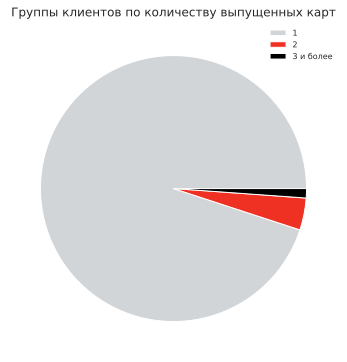

In [ ]:
plt.pie(grouped_clients['qty_owners'], colors=colors_ab)
plt.legend(labels=grouped_clients['qty_holders'].values, prop={'size':8}, frameon=False);

plt.title('Группы клиентов по количеству выпущенных карт')
plt.savefig(path + 'piechart.png');

Большинство владельцев карт являются так же едиственными держателями

In [ ]:
def plot_boxplot(df, column, q_low=0.01, q_high=0.99, vals_to_delete=0):
    df_plot = df[column]
    q99 = np.quantile(df_plot, q_high)
    q01 = np.quantile(df_plot, q_low)
    df_plot = df_plot[(df_plot < q99) & (df_plot > q01) & (df_plot != vals_to_delete)]

    sns.boxplot(df_plot.values)

def plot_boxplot_grouped(df, column, q_low=0.01, q_high=0.99, vals_to_delete=0, grouping='is_sponsor', style='plain', ax=None):
    df_plot = df[[column, grouping]]
    df_plot = df_plot[df_plot[column] != vals_to_delete]
    q99 = np.quantile(df_plot[column], q_high)
    q01 = np.quantile(df_plot[column], q_low)
    df_plot = df_plot[(df_plot[column] < q99) & (df_plot[column] > q01)]

    sns.boxplot(x=grouping, y=column, data=df_plot, palette=colors_ab, ax=ax)
    ax.ticklabel_format(style=style, axis='y', scilimits=(3, 3))
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(column, {'fontsize': 8})

def plot_histplot(df, column, q_low=0.01, q_high=0.99, vals_to_delete=0, ax=None):
    df_plot = df[column]
    q99 = np.quantile(df_plot, q_high)
    q01 = np.quantile(df_plot, q_low)
    df_plot = df_plot[(df_plot < q99) & (df_plot > q01) & (df_plot != vals_to_delete)]

    sns.histplot(df_plot.values, ax=ax)

def plot_countplot(df, column, hue=None, palette=colors_ab, ax=None):
    order = df.groupby(column)[column].count().sort_values(ascending=False).index
    sns.countplot(x=column, data=df, hue=hue, palette=colors_ab, ax=ax,)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(column, {'fontsize': 8})
    ax.legend(prop={'size': 8}, frameon=False)


In [ ]:
# названия колонок: кредиты, движения по счетам
col_banking = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='cat_banking').iloc[:, 0].to_list()
col_banking_qty = [i for i in col_banking if 'qty' in i]
col_banking_sum = [i for i in col_banking if i not in col_banking_qty]

# названия колонок: сумма трат по категории
col_amounts = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='cat_amounts').iloc[:, 0].to_list()

# названия колонок: средние траты по категории (сумма/кол-во покупок)
col_cat_avg = pd.read_excel(path + 'filling_nans.xlsx', sheet_name='cat_avg').iloc[:, 0].to_list()

# названия колонок с основными данными о клиентах
col_main_cat = ['accountsalary_flag',	'clientsegment', 'gender']
col_main_num = ['age', 'life_time_days']
col_region = ['addrref']


In [ ]:
fig, axes= plt.subplots(nrows=5, ncols=4, figsize=(13, 16))

for idx, feat in enumerate(col_cat_avg):
    ax = axes[int(idx / 4), idx % 4]

    plot_boxplot_grouped(df, column=feat, q_low=0.01, q_high=0.99, vals_to_delete=0, grouping='is_sponsor', style='sci', ax=ax)

plt.tight_layout()
plt.suptitle('Распределение средних трат по категориям в зависимости от таргета (1: "кормилец")', fontsize=12)
plt.tight_layout()

# plt.savefig(path + 'avg_spendings.png');

Во всех категориях траты кормильцев выше, чем у не-кормильцев



In [ ]:
fig, axes= plt.subplots(nrows=4, ncols=4, figsize=(13, 16))

for idx, feat in enumerate(col_banking_sum):
    ax = axes[int(idx / 4), idx % 4]

    plot_boxplot_grouped(df, column=feat, q_low=0.01, q_high=0.99, vals_to_delete=0, style='sci', grouping='is_sponsor', ax=ax)

plt.suptitle('Распределение остатков/движений по счетам (суммы) в зависимости от таргета (1: "кормилец")', fontsize=12)
plt.tight_layout()

# plt.savefig(path + 'finance.png');

Во всех категориях уровень денежных потоков у "кормильцев" выше, чем у "не-кормильцев"

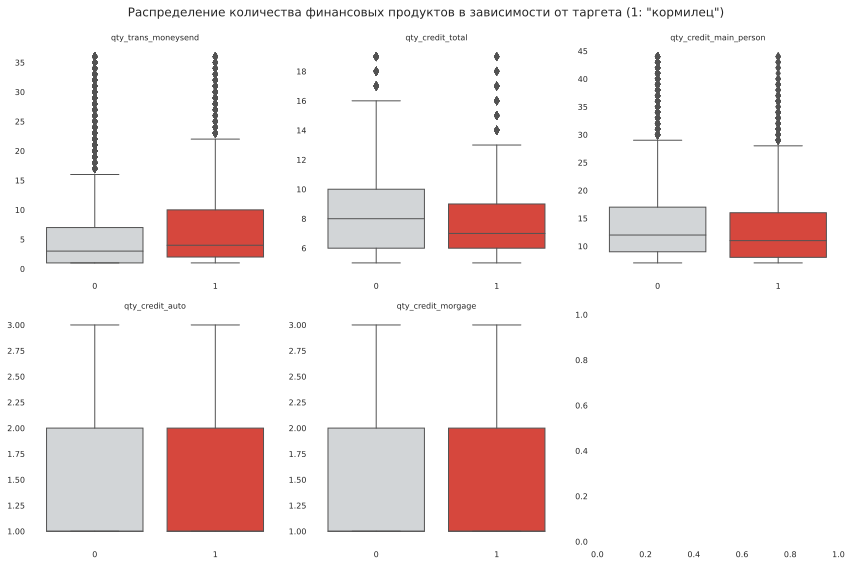

In [ ]:
fig, axes= plt.subplots(nrows=2, ncols=3, figsize=(12, 8))

for idx, feat in enumerate(col_banking_qty):
    ax = axes[int(idx / 3), idx % 3]
    plot_boxplot_grouped(df, column=feat, q_low=0.5, q_high=0.99, vals_to_delete=None, grouping='is_sponsor', ax=ax)

plt.suptitle('Распределение количества финансовых продуктов в зависимости от таргета (1: "кормилец")', fontsize=12)
plt.tight_layout()

plt.savefig(path + '/pics' + 'fin_products.png');

Распределение ипотек примерно одинаковое, что логично - в среднем человек покупает одну квартиру. Количество денежных переводов больше у "кормильцев", но количество кредитов больше у "не кормильцев". Возможно, это обусловлено тем, что люди c семьями распределяют кредиты между членами семьи

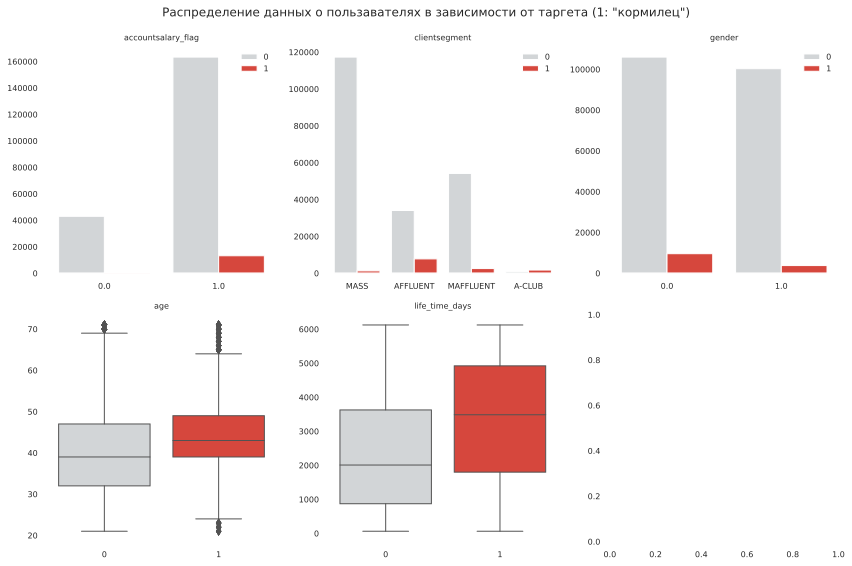

In [ ]:
# расределение данных в колонках с информацией о пользователях
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 8))
for idx, feat in enumerate(col_main_cat + col_main_num):
    ax = axes[int(idx / 3), idx % 3]
    if feat in col_main_cat:
        plot_countplot(df=df, column=feat, hue='is_sponsor', ax=ax)
    else:
        plot_boxplot_grouped(df=df, column=feat, q_low=0.01, q_high=0.99, vals_to_delete=0, grouping='is_sponsor', style='plain', ax=ax)

plt.suptitle('Распределение данных о пользавателях в зависимости от таргета (1: "кормилец")', fontsize=12)

plt.tight_layout()

# plt.savefig(path + 'general_info.png');

"Кормильцев больше в категориях:<br>
-клиентов, у которых AlfaBank является зарплатной картой<br>
-в сегментах "Affluent", "Maffluent"<br>
-больше мужского пола, чем женского, но разница примерно в два раза<br>
<br>
Также у данной группы:<br>
-выше медианный возраст(39 vs 43)<br>
-выше медианный срок польщованиями услугами АльфаБанка(2018 vs 3607 дней или 5.5 vs 9.9 лет)<br>

In [ ]:
df.groupby('is_sponsor')['life_time_days'].median()

is_sponsor
0    2000.0
1    3586.5
Name: life_time_days, dtype: float64

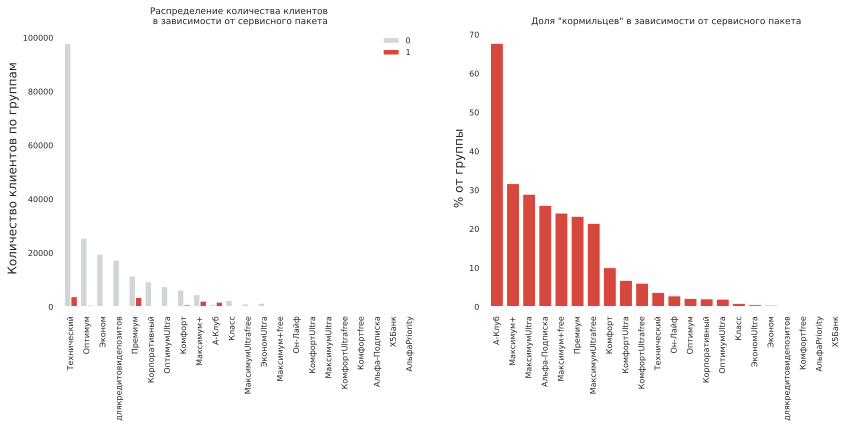

In [ ]:
# распределение кормильцев по пакетам услуг

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(14, 5))

order = df.groupby('srvpackage')['srvpackage'].count().sort_values(ascending=False).index
sns.countplot(x='srvpackage', data=df, hue='is_sponsor', order=order, palette=colors_ab, ax=ax[0])

ax[0].set_title(f'Распределение количества клиентов \nв зависимости от сервисного пакета', fontsize=9)
ax[0].set_xticklabels(order, rotation = 90)
ax[0].set_xlabel('')
ax[0].set_ylabel('Количество клиентов по группам')
ax[0].legend(prop={'size': 8}, frameon=False)

ct = pd.crosstab(df['srvpackage'], df['is_sponsor']).reset_index()
ct['0_%'] = (ct[0] / ct[[0, 1]].sum(axis=1) * 100)
ct['1_%'] = (ct[1] / ct[[0, 1]].sum(axis=1) * 100)
ct = ct.sort_values(by='1_%', ascending=False)

sns.barplot(data=ct, x='srvpackage', y='1_%', color='#EF3124', ax=ax[1])
labels = ct['srvpackage'].values

ax[1].set_title('Доля "кормильцев" в зависимости от сервисного пакета', fontsize=9)
ax[1].set_xticklabels(labels, rotation = 90)
ax[1].set_xlabel('')
ax[1].set_ylabel('% от группы')

# plt.savefig(path + '/pics' + 'service_package.png');

Самый большой % кормильцев в группе "А-клуб", "Maксимум+", "МаксимумUltra", "Альфа-Подписка". При этом это не самые многочисленные группы. Можно было бы понять эту зависимость если проанализировать особенности тарифов.

Text(0, 0.5, '% от клиентов по региону')

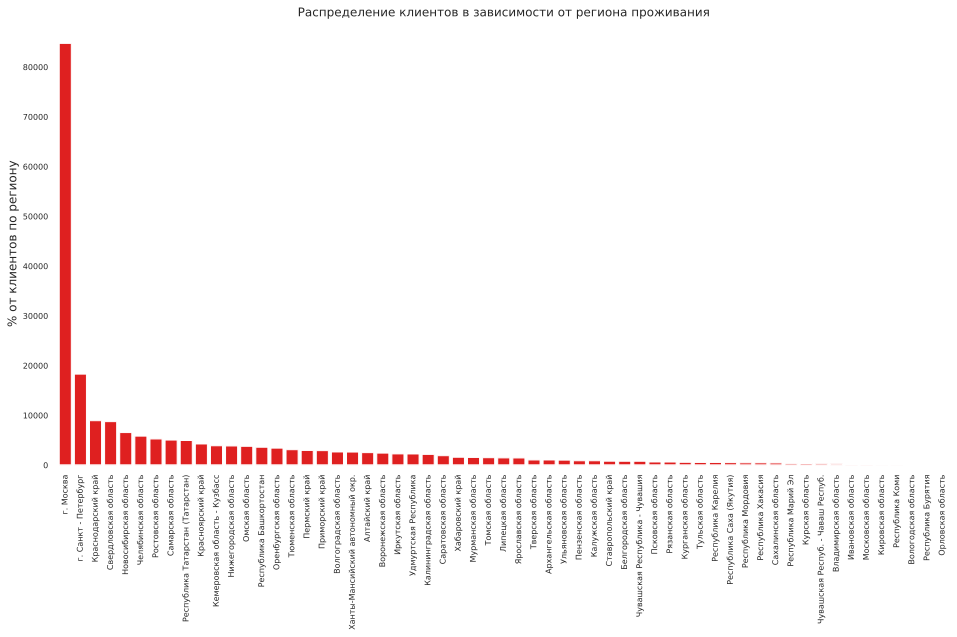

In [ ]:
# распределение кормильцев по городам

fig = plt.figure(figsize=[16, 8])
order = df.groupby('addrref')['addrref'].count().sort_values(ascending=False).index
sns.countplot(x='addrref', data=df, color='red', order=order)

plt.title('Распределение клиентов в зависимости от региона проживания', fontsize=12)
plt.xticks(rotation=90)
plt.xlabel('')
plt.ylabel('% от клиентов по региону')

# plt.savefig(path + 'region.png');

Ожидаемо, самые активные пользователи банка центральные регионы + Краснодарский край + Свердловская и Новосибирская область засчет крупных областных центров.

Text(0, 0.5, '% от клиентов по региону')

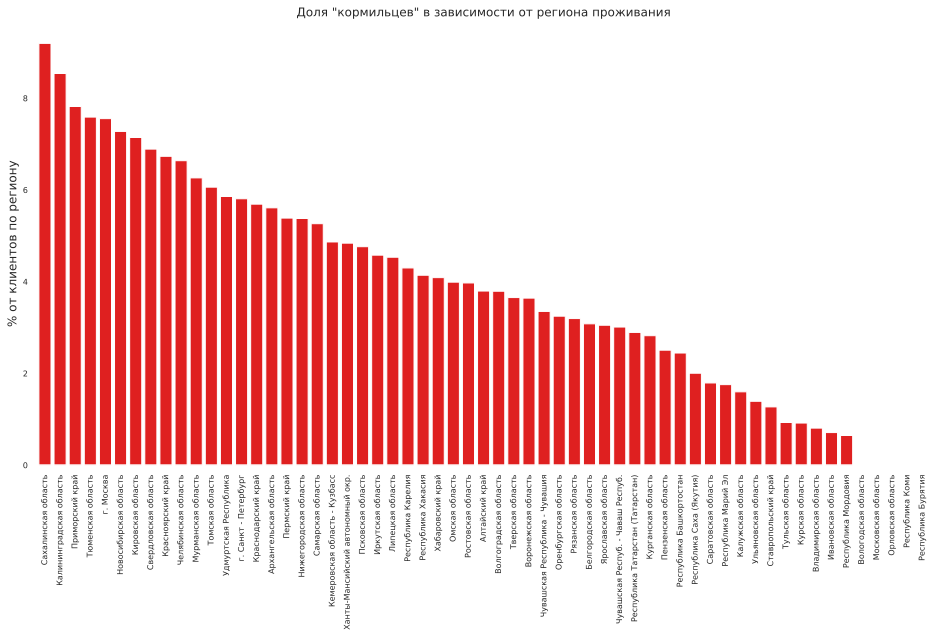

In [ ]:
# распределение кормильцев по городам

fig = plt.figure(figsize=[16, 8])

ct = pd.crosstab(df['addrref'], df['is_sponsor'])
ct['0_%'] = (ct[0] / ct[[0, 1]].sum(axis=1) * 100)
ct['1_%'] = (ct[1] / ct[[0, 1]].sum(axis=1) * 100)
ct = ct.sort_values(by='1_%', ascending=False)
sns.barplot(data=ct, x=ct.index, y='1_%', color='red')

plt.title('Доля "кормильцев" в зависимости от региона проживания', fontsize=12)
plt.xticks(rotation=90)
plt.xlabel('')
plt.ylabel('% от клиентов по региону')

# plt.savefig(path + 'region_share.png');


При этом самый большой процент "кормильцев" - на Сахалине, Калинградской области, Приморском крае

### *Вывод*

Выделеная нами целевая переменная имеет значимые различия в различных категориях. Наличие логичных закономерностей в данных позволяет нам использовать данный таргет для дальнейшего обучения моделей машинного обучения

## Подготовка данных для обучения модели

Поработаем с выбросами в данных. Постараемся сохранить максимум информации

In [ ]:
# колонки не требует обработки выбросов
col_ne_outlers = ['client_id', 'dt', 'accountsalary_flag', 'clientsegment', 'age',
       'gender', 'addrref', 'srvpackage', 'stratsegfactor', 'is_sponsor', 'clientoutflowstatus']

In [ ]:
# функция не удаляет выбросы, а заменяет их на 99 или 0.01 процентиль с определенныем шумом

def modif_outlers(data, col_list):
    for col in data.columns:
        if col not in col_list:
            quan_99 = data[col].quantile(0.99)
            quan_01 = data[col].quantile(0.01)
            data[col] = data[col].apply(lambda x: x if x < quan_99\
                                    else quan_99 + 100 * np.random.normal(loc=0.0, scale=1.0))
            if quan_01 < 0:
                data[col] = data[col].apply(lambda x: x if x >= quan_01\
                                    else quan_01 + 100 * np.random.normal(loc=0.0, scale=1.0))
    return data

In [ ]:
df_ = modif_outlers(df, col_ne_outlers)
df_validation = modif_outlers(df_validation, col_ne_outlers)

In [ ]:
# отберем названия колонок для соответвующих преобразований
col_for_ohe = ['clientsegment', 'stratsegfactor']
col_for_mte = ['addrref', 'srvpackage', 'clientoutflowstatus']
col_for_scal = ['age', 'life_time_days', 'addrref', 'srvpackage'] + list(df.iloc[:, 10:-1].columns)

In [ ]:
df_ = df_.sort_values('dt')
train = df_[:140000]
valid = df_[140000:175000]
test = df_[175000:]

In [ ]:
train.shape, df_validation.shape

((140000, 86), (21327, 85))

Выполним кодирование категориальных колонок

In [ ]:
# импортируем кастомный класс для кодирования категориальных признаков
# главный плюс это наглядность преобразований и сохранение исходной структуры датафрейма
# О атрубутах и методах класса вы можете ознакомится в документации или в скрупте в корневом каталоге
from custom_transformer_ohe_mte import CustomTransformer

In [ ]:
custom_trans = CustomTransformer(ohe_col=col_for_ohe, mte_col=col_for_mte, target='is_sponsor')

In [ ]:
train = custom_trans.fit_transform(train)
valid = custom_trans.transform(valid)
test = custom_trans.transform(test)
df_validation = custom_trans.transform(df_validation)

In [ ]:
train.shape, valid.shape, test.shape, df_validation.shape

((140000, 92), (35000, 92), (44653, 92), (21327, 91))

In [ ]:
# удалим колонки, которые не используются при обучении модели и выделим target
# сохраним список id клиентов для предсказания в df_validation

X_train = train.drop(['client_id', 'dt', 'is_sponsor'], axis=1)
X_valid = valid.drop(['client_id', 'dt', 'is_sponsor'], axis=1)
X_test = test.drop(['client_id', 'dt', 'is_sponsor'], axis=1)
y_train = train['is_sponsor']
y_valid = valid['is_sponsor']
y_test = test['is_sponsor']

clients_for_predict = df_validation['client_id'].values
df_validation = df_validation.drop(['client_id', 'dt'], axis=1)

In [ ]:
X_train.shape, df_validation.shape

((140000, 89), (21327, 89))

Так как мы планируем попробовать и ленейные простые модели, данные нужно отмассштабировать

In [ ]:
t = [('scaler', StandardScaler(), col_for_scal)]
col_transformer = ColumnTransformer(transformers=t, remainder='passthrough')

In [ ]:
X_train = col_transformer.fit_transform(X_train)
X_valid = col_transformer.transform(X_valid)
X_test = col_transformer.transform(X_test)
df_validation = col_transformer.transform(df_validation)

## Обучение моделей

### Датасет без корректировки дисбаланса

#### LogisticRegression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, PrecisionRecallDisplay

In [ ]:
# Функция формирования отчета по метрикам

def get_report(model, labels_list, data_list):
    from sklearn.metrics import auc, precision_recall_curve, roc_curve

    def get_auc_list():
        temp_list = []
        for i in range(len(labels_list)):
            fpr, tpr, _ = roc_curve(labels_list[i], model.predict_proba(data_list[i])[:,1])
            temp_list.append(auc(fpr, tpr))
        return temp_list

    def get_pr_list():
        temp_list = []
        for i in range(len(labels_list)):
            recall, prec, _ = precision_recall_curve(labels_list[i], model.predict_proba(data_list[i])[:,1])
            temp_list.append(auc(prec, recall))
        return temp_list

    report_train = pd.DataFrame(classification_report(labels_list[0],
                                                      model.predict(data_list[0]), output_dict=True))
    report_valid = pd.DataFrame(classification_report(labels_list[1],
                                                      model.predict(data_list[1]), output_dict=True))
    report_test = pd.DataFrame(classification_report(labels_list[2],
                                                      model.predict(data_list[2]), output_dict=True))

    accuracy = [report_train.iloc[0][2], report_valid.iloc[0][2], report_test.iloc[0][2]]
    f1_score = [report_train.iloc[2][1], report_valid.iloc[2][1], report_test.iloc[2][1]]
    precision = [report_train.iloc[0][1], report_valid.iloc[0][1], report_test.iloc[0][1]]

    rocauc = get_auc_list()

    prauc = get_pr_list()

    metric_df = pd.DataFrame(list(zip(accuracy, f1_score, rocauc, prauc, precision)),
                             columns=['accuracy', 'f1_score', 'ROCAUC', 'PRAUC', 'precision'],
                            index=['train', 'valid', 'test']).round(2).T

    return metric_df

In [ ]:
logit0 = LogisticRegression(random_state=1)

In [ ]:
logit0.fit(X_train, y_train)

LogisticRegression(random_state=1)

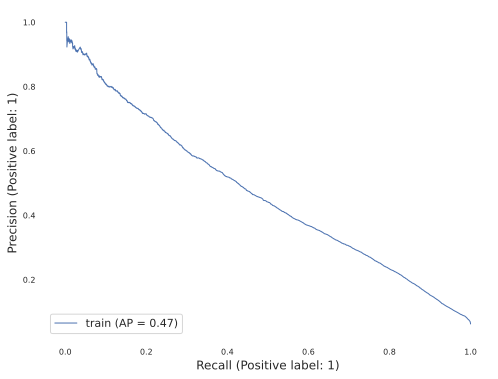

In [ ]:
PrecisionRecallDisplay.from_estimator(logit0, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_logreg0_train.png');

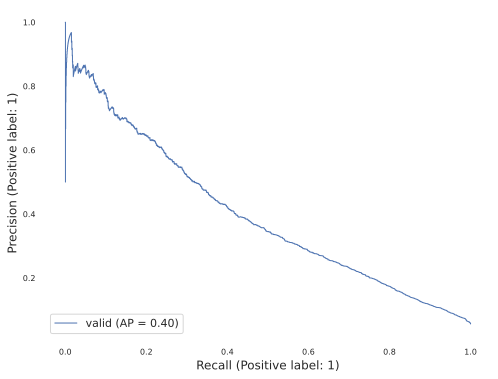

In [ ]:
PrecisionRecallDisplay.from_estimator(logit0, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_logreg0_valid.png');

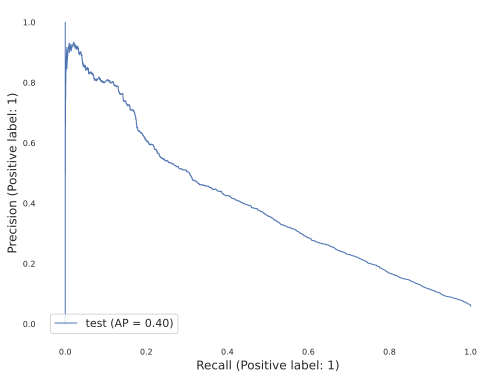

In [ ]:
PrecisionRecallDisplay.from_estimator(logit0, X_test, y_test, name='test')

plt.savefig(path + 'pics/' + 'PR_logreg0_test.png');

In [ ]:
print('LogisticRegression')
print()
print(get_report(logit0, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

LogisticRegression

           train  valid  test
accuracy    0.95   0.95  0.95
f1_score    0.35   0.26  0.27
ROCAUC      0.89   0.87  0.86
PRAUC       0.47   0.40  0.40
precision   0.66   0.68  0.71


Достаточно низкие метрики качества на всех выборках

#### RandomForestClassifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
forest0 = RandomForestClassifier(random_state=1)

In [ ]:
forest0.fit(X_train, y_train)

RandomForestClassifier(random_state=1)

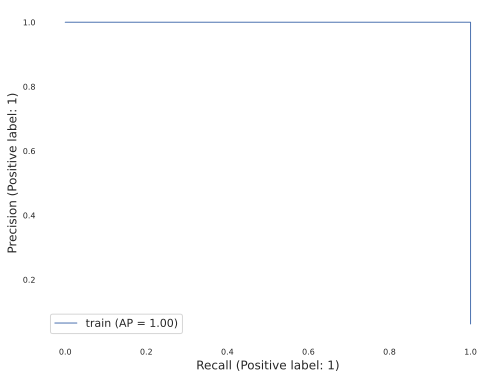

In [ ]:
PrecisionRecallDisplay.from_estimator(forest0, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_forest0_train.png');

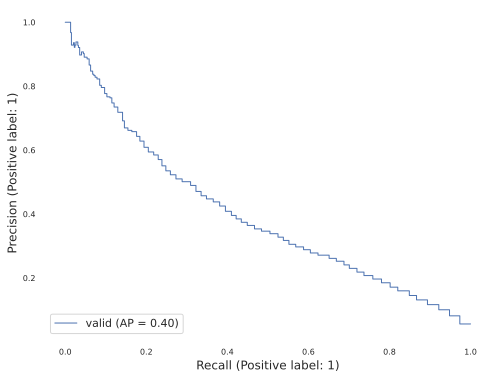

In [ ]:
PrecisionRecallDisplay.from_estimator(forest0, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_forest0_valid.png');

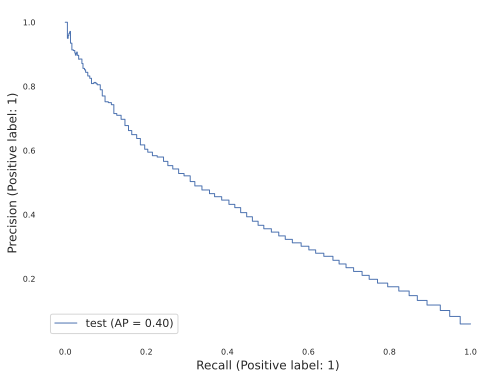

In [ ]:
PrecisionRecallDisplay.from_estimator(forest0, X_test, y_test, name='test')

plt.savefig(path + 'pics/' + 'PR_forest0_test.png');

In [ ]:
print('RandomForestClassifier')
print()
print(get_report(forest0, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

RandomForestClassifier

           train  valid  test
accuracy     1.0   0.95  0.95
f1_score     1.0   0.24  0.23
ROCAUC       1.0   0.87  0.87
PRAUC        1.0   0.40  0.41
precision    1.0   0.69  0.71


Достаточно низкие метрики качества на всех выборках

#### CatBoostClassifier

In [ ]:
# !pip install catboost

In [ ]:
from catboost import CatBoostClassifier

In [ ]:
catboost0 = CatBoostClassifier(random_state=1)

catboost0.fit(X_train, y_train)

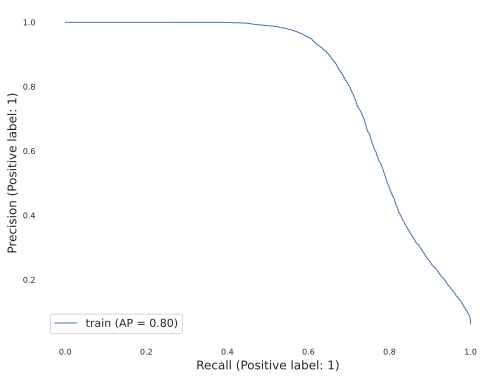

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost0, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_catboost0_train.png');

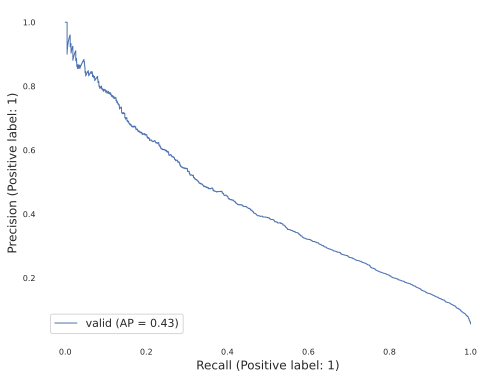

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost0, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_catboost0_valid.png');

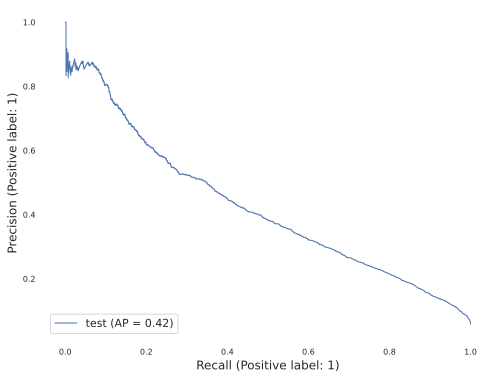

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost0, X_test, y_test, name='test')

plt.savefig(path + 'pics/' + 'PR_catboost0_test.png');

In [ ]:
print('CatBoostClassifier')
print()
print(get_report(catboost0, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

CatBoostClassifier

           train  valid  test
accuracy    0.97   0.95  0.95
f1_score    0.68   0.31  0.29
ROCAUC      0.95   0.89  0.89
PRAUC       0.80   0.43  0.42
precision   0.99   0.64  0.64


В данных присутвуют сильный дисбаланс классов, что может мешать моделям качественно установить зависимости в данных. Воспользуемся SMOTE подходом для выравнивания дисбаланса классов

### Датасет с выравниванием дисбаланса классов

In [ ]:
# ! pip install imbalanced-learn
from imblearn.over_sampling import SMOTE

In [ ]:
sm = SMOTE(random_state=1)

In [ ]:
# перобразовние только для train и valid
X_train, y_train = sm.fit_resample(X_train, y_train)
X_valid, y_valid = sm.fit_resample(X_valid, y_valid)

#### LogisticRegression

In [ ]:
logit = LogisticRegression(random_state=1)

In [ ]:
logit.fit(X_train, y_train)

LogisticRegression(random_state=1)

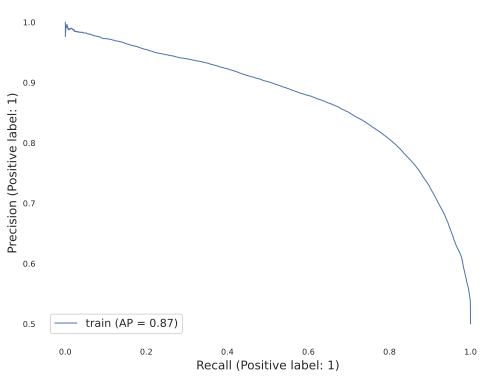

In [ ]:
PrecisionRecallDisplay.from_estimator(logit, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_logreg_train.png');

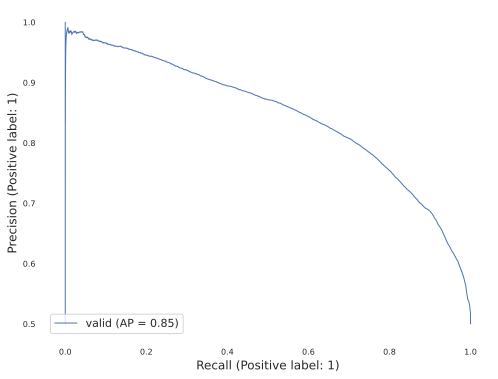

In [ ]:
PrecisionRecallDisplay.from_estimator(logit, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_logreg_valid.png');

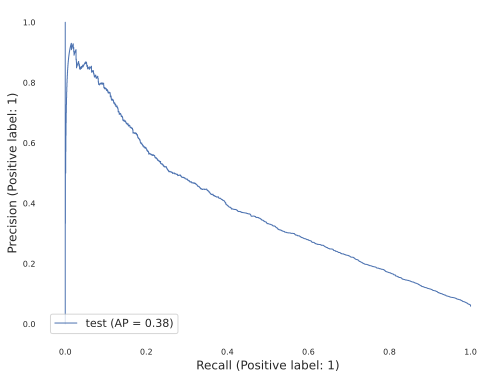

In [ ]:
PrecisionRecallDisplay.from_estimator(logit, X_test, y_test, name='test')

plt.savefig(path + 'pics/' + 'PR_logreg_test.png');

In [ ]:
print('LogisticRegression')
print()
print(get_report(logit, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

LogisticRegression

           train  valid  test
accuracy    0.80   0.77  0.80
f1_score    0.80   0.76  0.31
ROCAUC      0.88   0.85  0.86
PRAUC       0.87   0.85  0.38
precision   0.81   0.79  0.19


На сбалансированных даннных модель хорошо себя проявляет. Разница между train и valid небольшая, переобучение отсутсвует. Как то усложнить модель, чтобы лучше описать данные у нас не получится. Результаты модели на данных, которые она не видела, менее оптимистичные.

#### RandomForestClassifier

In [ ]:
forest = RandomForestClassifier(random_state=1)

In [ ]:
forest.fit(X_train, y_train)

RandomForestClassifier(random_state=1)

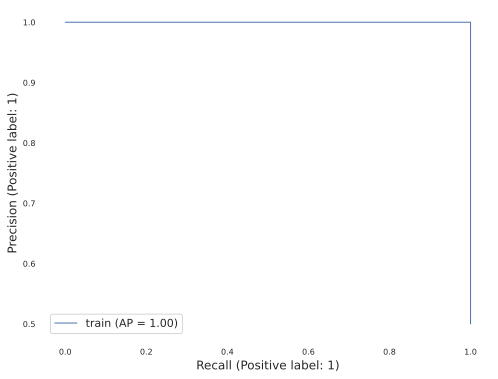

In [ ]:
PrecisionRecallDisplay.from_estimator(forest, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_forest_train.png');

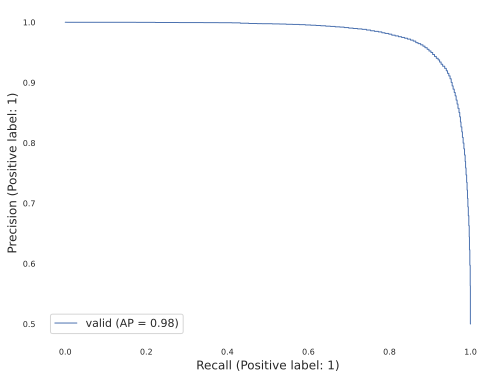

In [ ]:
PrecisionRecallDisplay.from_estimator(forest, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_forest_valid.png');

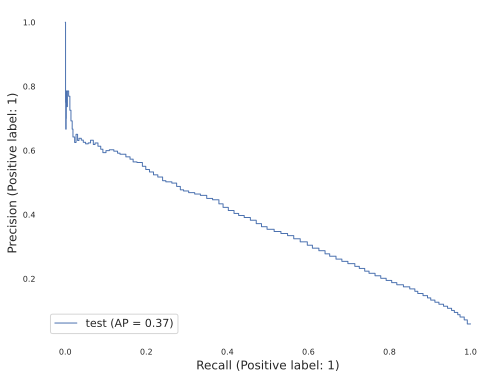

In [ ]:
PrecisionRecallDisplay.from_estimator(forest, X_test, y_test, name='test')

plt.savefig(path + 'pics/' + 'PR_forest_test.png');

In [ ]:
print('RandomForestClassifier')
print()
print(get_report(forest, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

RandomForestClassifier

           train  valid  test
accuracy     1.0   0.92  0.94
f1_score     1.0   0.91  0.40
ROCAUC       1.0   0.98  0.88
PRAUC        1.0   0.98  0.37
precision    1.0   0.97  0.46


Качество модели лучше, чем у LogisticRegression. f1_score и precision стали значительно выше. Так же можно отметить, что модель сильно переобучается, необходимо добавить регуляризации

#### CatBoostClassifier

In [ ]:
catboost = CatBoostClassifier(random_state=1)

In [ ]:
catboost.fit(X_train, y_train)

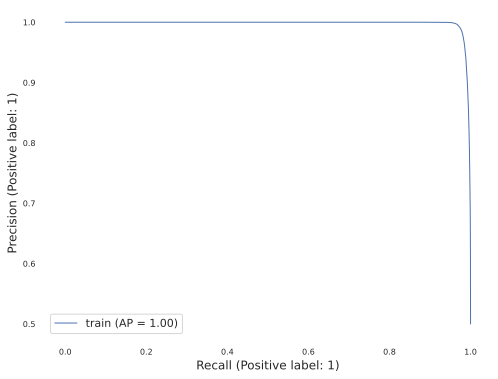

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost, X_train, y_train, name='train')

plt.savefig(path + 'pics/' + 'PR_catboost_train.png');

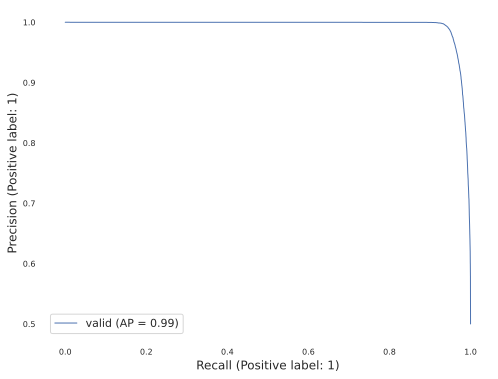

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost, X_valid, y_valid, name='valid')

plt.savefig(path + 'pics/' + 'PR_catboost_valid.png');

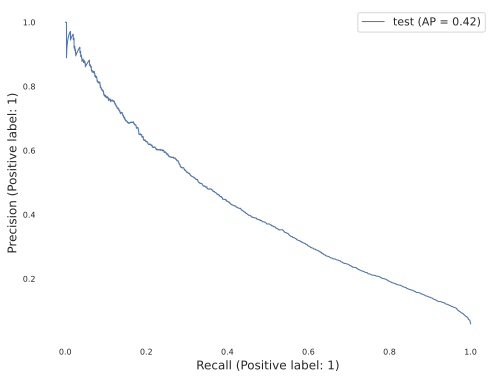

In [ ]:
PrecisionRecallDisplay.from_estimator(catboost, X_test, y_test, name='test')
plt.legend()
plt.savefig(path + 'pics/' + 'PR_catboost_test.png');

In [ ]:
print('CatBoostClassifier')
print()
print(get_report(catboost, labels_list=[y_train, y_valid, y_test],
           data_list=[X_train, X_valid, X_test]))

CatBoostClassifier

           train  valid  test
accuracy    0.98   0.97  0.95
f1_score    0.98   0.97  0.33
ROCAUC      1.00   0.99  0.88
PRAUC       1.00   0.99  0.42
precision   1.00   0.99  0.60


Результаты на валидационной выборке соизмеримы с работой RandomForestClassifier и близки к единице на валидационной выборке

Очевидно, что с использованием SMOTE подхода, качество моделей на валидационной выборке значительно выше. Применение семплирование оправдано при решение такого рода задач

### *Выводы по моделям*:

RandomForest и CatBoost достойно себя показали. <br>

В случае дисбаланса классов логично в качестве местрик использовать pr_auc и f_score. Но так как мы использовали семплирование за счет генерирование новых синтетических объектов, похожих на наш target, то модель научилась не только предсказывать сам target, но и объекты очень похожие на него(новые пользователи, которых мы ищем).  <br>

Следовательно получается, что нам не так важен precision в нашем случае. Поэтому во-первых, нет смысла долго подбирать гиперпараметры, достаточно, чтобы модель сильно не переобучалась. Во-вторых, будем улучшать только f_score на счет увеличения recall.

## Подбор гиперпараметров модели

In [ ]:
# функция для подбора оптимальной глубины дерева
def find_max_depth(param_list, labels_list, data_list):
    for elem in param_list:
        forest = RandomForestClassifier(random_state=1, max_depth=elem)
        forest.fit(data_list[0], labels_list[0])
        print()
        print(f'RandomForestClassifier: max_depth {elem}')
        print()
        print(get_report(forest, labels_list=labels_list,
                   data_list=data_list))

In [ ]:
# find_max_depth([5, 10, 15, 20],
#                labels_list=[y_train, y_valid, y_test],
#                data_list=[X_train, X_valid, X_test])

Оптимальное значение глубины дерева 15 (f1-score = 0.42). Обучим итоговую модель для дальнейшей работы

In [ ]:
forest_best = RandomForestClassifier(random_state=1, max_depth=15)

In [ ]:
forest_best.fit(X_train, y_train)

RandomForestClassifier(max_depth=15, random_state=1)

In [ ]:
# import pickle

# with open('forest_15_final.pkl', 'wb') as files:
#     pickle.dump(forest_best, files)

In [ ]:
# # with open('/kaggle/input/random-forest-final/forest_15_final.pkl' , 'rb') as f:
#     forest_best = pickle.load(f)

## Предсказания модели на df_validation

In [ ]:
score_df = pd.read_csv(path + 'score_file_filled.csv')

In [ ]:
# функция возращает df с предсказанными вероятнотями
def get_predict_df(send_df, clients, predicts):

    predict_df = pd.DataFrame(list(zip(clients, predicts)))\
                .rename(columns={0: 'client_id', 1: 'score'})
    return pd.merge(send_df.drop('score', axis=1), predict_df, on='client_id', how='left')

In [ ]:
predicts_proba = forest_best.predict_proba(df_validation)[:,1]

In [ ]:
len(predicts_proba)

21327

In [ ]:
score_file = get_predict_df(score_df, clients_for_predict, predicts_proba)

In [ ]:
score_file.head(10)

,client_id,score
0,3fbd8c4b629545972d6bcba74f367c10cabc0f2d2715f5...,0.022104
1,1ee25fb2b3b07d2f165d15bd9b95f0e6d8cfccf586468d...,0.396361
2,aea24d61bb2f0eeb0ff4f897ce4037f58eff29acbd4e36...,0.249956
3,1318bbf375035082f93aebf102249b110abda93d9970a1...,0.000000
4,6627d4565339a64bba25275af2eb8f3c1bcf3008ce3948...,0.299984
5,782377ade0030bd4c13566d5412cc6bc606f7b061d4674...,0.021751
6,5d360f2e880cbe6b6d2b0ff379c8720f68c1247a1cef35...,0.026788
7,311bd3f9b18a49c1e4466b001922bca1c4cd250def6ba0...,0.140610
8,ce30ee8699c1ce73b6a744d3d94ced918a87db22247090...,0.197363
9,422a789bccb74b9426b7202409b87d139f471d7e4c8068...,0.838445


In [ ]:
# в ячейках c nan поставим вероятность 0

score_file = score_file.fillna(0)

In [ ]:
score_file.to_csv(path + 'score_file_filled.csv', index=False)

## Поиск кластеров в данных

Гипотеза: Некоторые пользователи могут быть похожи сами по себе, в паттернах поведения и не только. То есть решить задачу можно от обратного - выделить кластеры изучить, что у этих пользовтелей общего и уже выделить кластер или группу кластеров как новый таргет. Затем уже стоить на этом модели машинного обучения, делать предсказания и уже собирать обратную связь. Кстати, при таком подходе могут обнаружится и другие неменее интересные инсайды

Посмотрим на распределения данных с помощью метода TSNE

In [ ]:
from sklearn.manifold import TSNE

In [ ]:
disbal_df_tsne = TSNE(n_components=2, perplexity=20, n_iter=1000, random_state=1).fit_transform(X_test[:10000])

In [ ]:

disbal_df_tsne = np.concatenate((disbal_df_tsne, y_test[:10000].values.reshape(-1, 1)), axis=1)
disbal_df_tsne = pd.DataFrame(disbal_df_tsne, columns=['x', 'y', 'target'])
disbal_df_tsne['target'] = disbal_df_tsne['target'].astype('category')

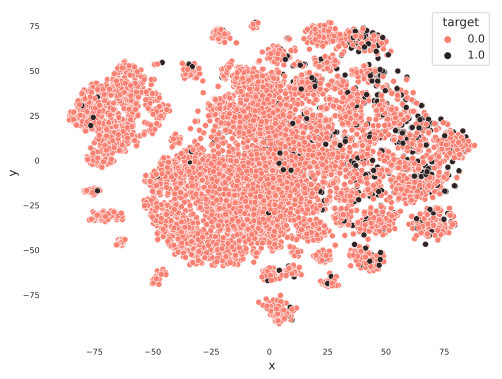

In [ ]:
fig = plt.figure()
fig.set_size_inches(8, 6)

sns.scatterplot(data=disbal_df_tsne
                , x='x'
                , y='y'
                , hue='target'
                , palette='dark:salmon_r')

plt.savefig(path + 'TSNE.png');

### *Выводы*

- с одной стороны таргет, который мы выделили ранее распределен хаотично и нельзя сделать каких-либо разумных выводов
- с другой стороны наблюдаются другие конгломераты в данных, на котрых можно обратить внимание при дальнейшем исследовании. Главный вопрос: что объединяет этих клиентов? Возможно нам это откроет идеи для новых продуктов

## Взаимодействие с клиентами

Более подробно, наглядно и красочно о методах взаимодействий с клиентами и предложнениями вы можете ознакомится в презентации в корневом каталоге в файле ***presentation.pdf***